Análisis para la Visualización
1. Limpieza de datos: imputación de valores nulos
2. Creación de tabla categorías
3. Análisis de los datos

In [2]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np

import folium
from folium.plugins import HeatMap


In [3]:
servicio_restaurantes = pd.read_csv('../processed_data/servicio_restaurantes.csv')

## 1. Conociendo los datos

In [3]:
print(servicio_restaurantes.info())
servicio_restaurantes.head(2)

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 70391 entries, 0 to 70390
Data columns (total 20 columns):
 #   Column                     Non-Null Count  Dtype  
---  ------                     --------------  -----  
 0   id_servicios_restaurantes  70391 non-null  object 
 1   servicios_restaurantes     70391 non-null  object 
 2   direccion                  70391 non-null  object 
 3   id_condado                 70391 non-null  object 
 4   condado                    70391 non-null  object 
 5   codigo_postal_condado      70391 non-null  object 
 6   latitud_condado            70391 non-null  float64
 7   longitud_condado           70391 non-null  float64
 8   id_ciudad                  70391 non-null  object 
 9   ciudad                     70391 non-null  object 
 10  codigo_postal_ciudad       70391 non-null  object 
 11  latitud_ciudad             70391 non-null  float64
 12  longitud_ciudad            70391 non-null  float64
 13  estado                     70391 non-null  obj

,id_servicios_restaurantes,servicios_restaurantes,direccion,id_condado,condado,codigo_postal_condado,latitud_condado,longitud_condado,id_ciudad,ciudad,codigo_postal_ciudad,latitud_ciudad,longitud_ciudad,estado,categorias,puntuacion_usuarios,analisis_sentimientos,url_del_negocio,enlaces_google_maps,anio
0,05HTY,ruby tuesday,"Kirkman Road, Orlando",lomP,Orange,"32801, 32839, 32789",28.484499,-81.251883,20si,apopka,32811,28.503323,-81.458029,Florida,NaN,NaN,NaN,NaN,NaN,2023
1,R252A,denny's,"Kirkman Road, Orlando",lomP,Orange,"32801, 32839, 32789",28.484499,-81.251883,20si,apopka,32811,28.502807,-81.458022,Florida,NaN,NaN,NaN,NaN,NaN,2023


## 2. Limpieza de datos

Se eliminan innecesarias para el análisis o con mucha cantidad de valores nulos

In [4]:
servicio_restaurantes.drop(columns=['url_del_negocio', 'enlaces_google_maps','analisis_sentimientos'], inplace=True)

In [5]:
servicio_restaurantes.anio.unique()

array([2023, 2024, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018,
       2019, 2020, 2021, 2022], dtype=int64)

In [6]:
print(servicio_restaurantes.shape)
servicio_restaurantes.isnull().sum()

(70391, 17)


id_servicios_restaurantes       0
servicios_restaurantes          0
direccion                       0
id_condado                      0
condado                         0
codigo_postal_condado           0
latitud_condado                 0
longitud_condado                0
id_ciudad                       0
ciudad                          0
codigo_postal_ciudad            0
latitud_ciudad                  0
longitud_ciudad                 0
estado                          0
categorias                   9139
puntuacion_usuarios          9139
anio                            0
dtype: int64

### Eliminación de nulos en dirección, categorias y puntuación_usuarios. 



Categorías, se rellenan los valores en base a valores existentes del mismo restaurante

In [22]:
# Rellenar los valores nulos en 'categorías' con base en 'id_servicios_restaurantes' o 'servicios_restaurantes'
# Reemplazar valores que no pudieron ser rellenados con 'No brindado'

# Configuración para optar por el comportamiento futuro
pd.set_option('future.no_silent_downcasting', True)

servicio_restaurantes['categorias'] = (
    servicio_restaurantes.groupby(['id_servicios_restaurantes', 'servicios_restaurantes'])['categorias'].transform(lambda x: x.bfill().ffill()))


servicio_restaurantes['categorias'] = servicio_restaurantes['categorias'].fillna('No brindado')

Puntuación de usuarios

In [24]:
# Promedio por año
promedios_anuales = servicio_restaurantes.groupby('anio')['puntuacion_usuarios'].mean()
# Para el año 2023
puntuaciones_2022 = servicio_restaurantes[servicio_restaurantes['anio'] == 2022]['puntuacion_usuarios'].dropna().values
puntuaciones_2024 = servicio_restaurantes[servicio_restaurantes['anio'] == 2024]['puntuacion_usuarios'].dropna().values
# Combinar puntuaciones de ambos años
puntuaciones_referencia = np.concatenate([puntuaciones_2022, puntuaciones_2024])

# Función para imputar valores
def imputar_valores(fila):
    if pd.isnull(fila['puntuacion_usuarios']):
        # Si es nulo busca el promedio del año
        promedio_anio = promedios_anuales.get(fila['anio'])
        return round(promedio_anio,1)
    else:
        return fila['puntuacion_usuarios']

# Función para imputar en 2023
def imputar_copiar_2022_2024(fila):
    if pd.isnull(fila['puntuacion_usuarios']) and fila['anio'] == 2023:
        # Seleccionar aleatoriamente un valor de los años 2022 y 2024 y agrega una variación
        valor_aleatorio = np.random.choice(puntuaciones_referencia) + np.random.uniform(-0.2, 0.2)
        return round(valor_aleatorio, 1)
    else:
        return fila['puntuacion_usuarios']

# Asignan los valores para el 2024
servicio_restaurantes['puntuacion_usuarios'] = servicio_restaurantes.apply(imputar_valores, axis=1)
# Aplicar la función para el 2023
servicio_restaurantes['puntuacion_usuarios'] = servicio_restaurantes.apply(imputar_copiar_2022_2024, axis=1)



In [25]:
print(servicio_restaurantes.shape)
servicio_restaurantes.isnull().sum()

(70391, 17)


id_servicios_restaurantes    0
servicios_restaurantes       0
direccion                    0
id_condado                   0
condado                      0
codigo_postal_condado        0
latitud_condado              0
longitud_condado             0
id_ciudad                    0
ciudad                       0
codigo_postal_ciudad         0
latitud_ciudad               0
longitud_ciudad              0
estado                       0
categorias                   0
puntuacion_usuarios          0
anio                         0
dtype: int64

## 3. Creación de la tabla categorías

- Tabla de categorias con id unicos:  `categorias_dim`
- Tabla de categorias relacionadas con id_servicios_restaurante:  `ciudad`

In [26]:
# Copia de las columnas necesarias
categorias_rest = servicio_restaurantes[['id_servicios_restaurantes', 'categorias']].copy()

# Limpieza de las categorías
# 1. Quitar corchetes y comillas inconsistentes
# 2. Eliminar espacios extra alrededor de las categorías
categorias_rest['categorias'] = (
    categorias_rest['categorias']
    .str.replace(r"[\'\"\[\]]", "", regex=True)  # Elimina caracteres no deseados
    .str.split(", ")  # Divide las categorías por coma y espacio
)

# Explosion de las categorías en filas individuales
categorias_rest = categorias_rest.explode('categorias')

# Reemplazar valores nulos o vacíos con 'No brindado'
categorias_rest['categorias'] = categorias_rest['categorias'].fillna('No brindado').str.strip()

# Crear la tabla de categorías únicas
unique_categories = categorias_rest['categorias'].drop_duplicates().reset_index(drop=True)

# Crear la tabla categorias_dim con ids únicos
categorias_dim = pd.DataFrame({
    'id_category': range(1, len(unique_categories) + 1),
    'category': unique_categories
})

# Relacionar las categorías únicas con los ids de servicios
categorias = categorias_rest.merge(categorias_dim, left_on='categorias', right_on='category', how='left')
categorias = categorias[['id_servicios_restaurantes', 'id_category']]

# Eliminación columna cateogira
servicio_restaurantes.drop(['categorias',], axis=1, inplace=True)

In [27]:
categorias_rest.head(5)

,id_servicios_restaurantes,categorias
0,05HTY,American restaurant
0,05HTY,Bar
0,05HTY,European restaurant
0,05HTY,Restaurant
1,R252A,Diner


In [28]:
categorias_dim.head(5)

,id_category,category
0,1,American restaurant
1,2,Bar
2,3,European restaurant
3,4,Restaurant
4,5,Diner


Asignación de categorías a categorías generales:
- Ejemplo:
"Cocina Asiática": ["asian", "bangladeshi","shanghainese", ...]

In [44]:
import re

# Definir palabras clave para cada categoría general
categorias_generales= {
    'Cocina Europea':['spanish','italian','greek','german','scottish','french','mediterranean','middle eastern','italian restaurant','modern french restaurant','mediterranean restaurant',
                      'middle eastern restaurant','european restaurant','german restaurant','northern italian restaurant'
                      ,'spanish restaurant','french restaurant','greek restaurant','portuguese restaurant','georgian restaurant','persian restaurant'], 
    'Cocina Asiática':['fusion restaurant','ramen restaurant','japanese','chinese','thai','vietnamese','filipino','korean','indian','asian fusion','chinese restaurant','asian fusion restaurant','korean barbecue restaurant',
                       'japanese restaurant','indonesian restaurant', 'filipino restaurant',
                       'korean restaurant','sushi restaurant','vietnamese restaurant','thai restaurant','indian restaurant','asian restaurant',
                       'authentic japanese restaurant','chophouse restaurant'],
    "Comida Vegetariana":['vegetarian restaurant','vegetarian','vegan','salad','vegan restaurant',],
    "Cocina Caribeña y Latina":['mexican','peruvian','cuban','caribbean','puerto rican restaurant','cuban restaurant','mexican restaurant','latin american',
                                'caribbean restaurant','nicaraguan restaurant','armenian restaurant',
                                'latin american restaurant','dominican restaurant','honduran restaurant','pan-latin restaurant','peruvian restaurant',
                               'tex-mex restaurant','brazilian restaurant','nuevo latino restaurant','guatemalan restaurant','salvadoran restaurant',],
    'Cocina Suramericana': ['brazilian','colombian restaurant','venezuelan','argentinian restaurant','venezuelan restaurant'],
    'Comida de mar':['seafood','seafood restaurant'],
    'Cocina Africana': ['west african restaurant'],
    'Comida americana':['traditional american restaurant', 'chicken wings','american restaurant','american (new)','southern restaurant (us)','american (traditional)','chicken wings restaurant',
                        'country food restaurant','chicken restaurant','hawaiian restaurant','new american restaurant'],
    'Comida especializada':['irish restaurant','halal','soul food','health markets','soul food restaurant','jamaican restaurant','health food restaurant','ethiopian restaurant',
                            'cape verdean restaurant','cajun restaurant','israeli restaurant','lebanese restaurant','kosher restaurant','hot pot restaurant','haitian restaurant','halal restaurant'],
    'Comida rápida':['fast food','pizza','diners','fast food','hot dogs','pizza restaurant','sandwich shop','taco restaurant','fast food restaurant','sandwiches',
                     'pizza delivery','food trucks','burgers','delivery restaurant','hot dog restaurant','cheesesteak restaurant','takeout restaurant','hamburger restaurant',
                     'pizza takeout'],
    'Postres, Snacks y cafeterias':['snack bar','tapas restaurant','espresso bar','dessert restaurant','bakeries','bagels','coffe & tea','cafes','donuts','juice bars & smoothies','waffles','cafe','deli','tapas bar','internet cafe',
                                    'cafeteria','bistro','art cafe','coffee shop'],
    'Bares y Vida Nocturna': ['piano bar','bars','bar','bar stool supplier','hookah bar','nightlife','comedy clubs','adult entertainment club','cocktail bar','night club','wine store','wine bar',
                              'video arcade','sports bar','bartenders','liquor store','gay bar','bartending school','oyster bar restaurant',],
    'Parrilladas y Carnes':['steakhouses','barbeque','bar & grill','barbecue restaurant','grill store'],
    'Gastronomía y Eventos':['buffetts','wine & spirits', 'delis','breakfast & brunch','event venue','event planning & services','caterers','breakfast restaurant',
               'party planner', 'fine dining restaurant','buffet restaurant','brunch restaurant','lunch restaurant','caterer'], 
    'Restaurantes y servicios':['barber shop','auto repair shop','hair salons','association or organization','eyebrow bar','arts & entertainment','cinema', 'diner'
                                'dinner theater','restaurants','beauty & spas','barbers','health & medical','oxygen bars','iv hydration','active life',
                                'cardio classes','womens clothing','fashion','shopping','fitness & instruction','kiosk','restaurant','family restaurant','entertainment agency',
                                'attorney','baby clothing store','business center','beauty supply store','restaurant supply store','barber supply store',
                                'landscaping supply store','down home cooking restaurant','store','car dealer','barber school']
} 

# Se asigna la categoría general basada en palabras clave
def asignar_categoria_general(categoria):
    categoria = categoria.lower() 
    for categoria_general, palabras_clave in categorias_generales.items():
        # Si alguna palabra clave está en la categoría específica, asignamos
        if any(re.search(palabra, categoria) for palabra in palabras_clave):
            return categoria_general
    return "Otros"  # categoría por defecto si no hay coincidencias

# Aplicar la función al dataframe
categorias_dim2 =categorias_dim.copy() 
categorias_dim2['general_category'] = categorias_dim2['category'].apply(asignar_categoria_general) # nueva columna

# Se obtiene nueva tabla categoria generales
categoria_generales = categorias_dim2[['general_category']].drop_duplicates().reset_index(drop=True)
categoria_generales['id_general_category'] = range(1, len(categoria_generales) + 1)

# relacion con la tabla original categorias
categorias_dim2 = categorias_dim2.merge(categoria_generales, on='general_category', how='left')
# Eliminar la columna general_category
categorias_dim2 = categorias_dim2.drop(columns=['general_category'])

# Relación con categorias por restaurante 
categorias_restaurant = categorias.merge(categorias_dim2, on='id_category', how='left')
categorias_restaurant = categorias_restaurant.drop(columns=['id_category','category'])
categorias_restaurant = categorias_restaurant[['id_servicios_restaurantes',"id_general_category"]].drop_duplicates().reset_index(drop=True)

In [45]:
# Todas las categorías generales
categoria_generales

,general_category,id_general_category
0,Comida americana,1
1,Bares y Vida Nocturna,2
2,Cocina Europea,3
3,Restaurantes y servicios,4
4,Otros,5
5,Gastronomía y Eventos,6
6,Comida rápida,7
7,Comida de mar,8
8,"Postres, Snacks y cafeterias",9
9,Cocina Caribeña y Latina,10


In [47]:
categorias_dim2.head(3)

,id_category,category,id_general_category
0,1,American restaurant,1
1,2,Bar,2
2,3,European restaurant,3


In [50]:
categorias_restaurant.head(5)

,id_servicios_restaurantes,id_general_category
0,05HTY,1
1,05HTY,2
2,05HTY,3
3,05HTY,4
4,R252A,5


## 4.  EDA: Validación de datos, análisis descriptivo, relación entre variables.

In [52]:
servicio_restaurantes.head(1)

,id_servicios_restaurantes,servicios_restaurantes,direccion,id_condado,condado,codigo_postal_condado,latitud_condado,longitud_condado,id_ciudad,ciudad,codigo_postal_ciudad,latitud_ciudad,longitud_ciudad,estado,puntuacion_usuarios,anio
0,05HTY,ruby tuesday,"Kirkman Road, Orlando",lomP,Orange,"32801, 32839, 32789",28.484499,-81.251883,20si,apopka,32811,28.503323,-81.458029,Florida,5.1,2023


### **Validación de los datos:**
- Tipo correcto de los datos
- Evaluación de outliers
  
Columna numérica: puntuacion_ususarios

In [53]:
# verificar tipo de datos
columnas= servicio_restaurantes.columns.to_list()

for col in columnas:
    print(f'Columna:{col}, Valor: {(servicio_restaurantes[col][0])},    Tipo:{type(servicio_restaurantes[col][0])} ')

Columna:id_servicios_restaurantes, Valor: 05HTY,    Tipo:<class 'str'> 
Columna:servicios_restaurantes, Valor: ruby tuesday,    Tipo:<class 'str'> 
Columna:direccion, Valor: Kirkman Road, Orlando,    Tipo:<class 'str'> 
Columna:id_condado, Valor: lomP,    Tipo:<class 'str'> 
Columna:condado, Valor: Orange,    Tipo:<class 'str'> 
Columna:codigo_postal_condado, Valor: 32801, 32839, 32789,    Tipo:<class 'str'> 
Columna:latitud_condado, Valor: 28.4844995,    Tipo:<class 'numpy.float64'> 
Columna:longitud_condado, Valor: -81.2518833,    Tipo:<class 'numpy.float64'> 
Columna:id_ciudad, Valor: 20si,    Tipo:<class 'str'> 
Columna:ciudad, Valor: apopka,    Tipo:<class 'str'> 
Columna:codigo_postal_ciudad, Valor: 32811,    Tipo:<class 'str'> 
Columna:latitud_ciudad, Valor: 28.5033228,    Tipo:<class 'numpy.float64'> 
Columna:longitud_ciudad, Valor: -81.4580286,    Tipo:<class 'numpy.float64'> 
Columna:estado, Valor: Florida,    Tipo:<class 'str'> 
Columna:puntuacion_usuarios, Valor: 5.1,    Ti

Se verifica que todos los condados del Estado de Florida, se encuentren o sean correctos:
- normalizar las ciudades eje: 'Saint Petersburg'
'St. Petersburg'

In [130]:
# API para obtener una lista de los condados en base al censo de EEUU
import requests

# Paso 1: Obtener la lista de condados en Florida (código FIPS de Florida: 12)
def get_florida_counties():
    url = "https://api.census.gov/data/2020/dec/pl?get=NAME&for=county:*&in=state:12"
    response = requests.get(url)
    data = response.json()
    
    # Formatear los condados
    counties = [{ item[0]} for item in data[1:]]
    return counties

florida_counties = get_florida_counties()

# Extraer solo los nombres de los condados
condados_censo = sorted([list(item)[0].split(",")[0].replace(" County", "") for item in florida_counties])

# Condados de la ciudades_dim
ciudades_dim_condados = servicio_restaurantes.condado.unique().tolist()
# ciudades_dim_condados= sorted(ciudades_dim.condado.unique().tolist())

# Comparar la lista de condados
if condados_censo == ciudades_dim_condados:
    print("Las listas son iguales.")
else:
    # Imprimir elementos que no coinciden
    diff1 = set(condados_censo) - set(ciudades_dim_condados)
    diff2 = set(ciudades_dim_condados) - set(condados_censo)

    if diff1:
        print(f"Elementos en 'condados_censo' pero no en 'servicio_restaurantes': {diff1}")
    if diff2:
        print(f"Elementos en 'servicio_restaurantes' pero no en 'condados_censo': {diff2}")


Elementos en 'condados_censo' pero no en 'servicio_restaurantes': {'Liberty'}


Nos indica que existe un condado que no se encuentra dentro del dataset de restaurante, pero no es un error. Sí fuera al revez, donde obtenemos un condado que no se encuentra o coincide con la lista de condados del censo, sí se realizaría un análisis más profundo.

In [54]:
# mismos valores de ciudad para un mismo valor. Eje: 'san petersburgo', 'St. Petersburg', 'San Petersburgo', 'Saint Petersburg'
mapeo_ciudades = {
    'san petersburgo': 'St. Petersburg',
    'San Petersburgo': 'St. Petersburg',
    'Saint Petersburg': 'St. Petersburg'
}

servicio_restaurantes['ciudad'] = servicio_restaurantes['ciudad'].replace(mapeo_ciudades)

servicio_restaurantes[servicio_restaurantes['condado']=='Pinellas'].ciudad.unique()
# St. Petersburg

array(['St. Petersburg', 'Largo', 'Clearwater', 'Pinellas Park',
       'St Pete Beach', 'Palm Harbor', 'Oldsmar', 'Dunedin',
       'Tarpon Springs', 'Kenneth City', 'Clearwater Beach',
       'Treasure Island', 'North Redington Beach', 'Seminole', 'Gulfport',
       'Indian Rocks Beach', 'Madeira Beach', 'South Pasadena',
       'Safety Harbor', 'Redington Shores', 'Tierra Verde',
       'St. Pete Beach', 'Belleair Bluffs', 'Indian Shores',
       'Tarpon springs', 'Palm harbor', 'Pinellas park',
       'Indian Rocks Beach. ', 'LARGO'], dtype=object)

### **Análisis de outliers:** 

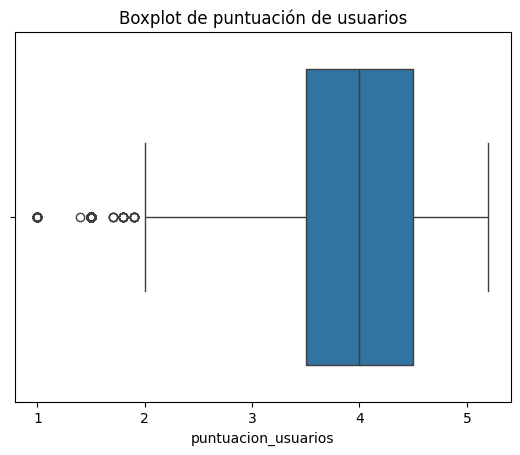

In [55]:
# Boxplot 
sns.boxplot(x=servicio_restaurantes['puntuacion_usuarios'])
plt.title("Boxplot de puntuación de usuarios")
plt.show()


*Conclusión*: Los outliers representan las puntuaciones bajas por los usuarios a partir de valores menos a 2, por lo tanto la mayoria de puntuaciones y lo común se encuentran entre 3.5 y 4.5

### **Estadística descriptiva**
- Se utilizan las medidas de tendencia central: media, mediana y moda
- Medidas de dispersión: varianza y desviación estándar

In [56]:
# Análisis descriptivo
print(servicio_restaurantes['puntuacion_usuarios'].describe())

print('\n***** Medidas de Tendencia Central *****')
print(f"Media: {servicio_restaurantes['puntuacion_usuarios'].mean():.2f}")
print(f"Mediana: {servicio_restaurantes['puntuacion_usuarios'].median()}")
print(f"Moda: {servicio_restaurantes['puntuacion_usuarios'].mode()[0]}")

print('\n***** Medidas de Dispersión **********')
print(f"Varianza: {servicio_restaurantes['puntuacion_usuarios'].var():.2f}")
print(f"Desviación estándar: {servicio_restaurantes['puntuacion_usuarios'].std():.2f}")

count    70391.000000
mean         3.994516
std          0.609423
min          1.000000
25%          3.500000
50%          4.000000
75%          4.500000
max          5.200000
Name: puntuacion_usuarios, dtype: float64

***** Medidas de Tendencia Central *****
Media: 3.99
Mediana: 4.0
Moda: 4.0

***** Medidas de Dispersión **********
Varianza: 0.37
Desviación estándar: 0.61


*Conclusión*: 

### **Distribución de datos**
- Uso de histogramas para entender si los datos están distribuidos normalmente o no.

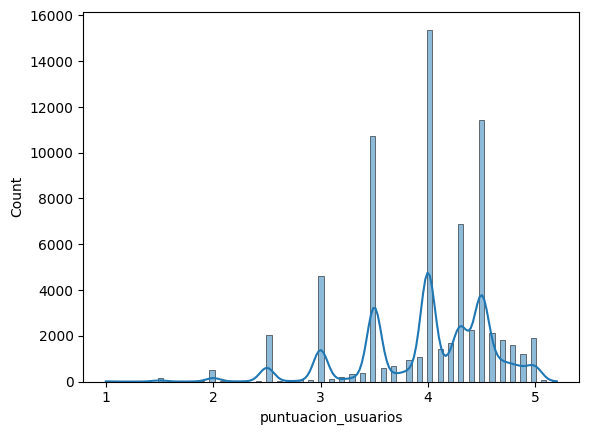

In [57]:
sns.histplot(servicio_restaurantes['puntuacion_usuarios'], kde=True)
plt.show()

*Conclusión*: 

### **Variable categórica**
- Analisís de las frecuencias y proporciones de variables categóricas para entender su distribución.

In [58]:
# conteo de frecuencia
print(servicio_restaurantes['ciudad'].value_counts())
print(servicio_restaurantes['condado'].value_counts())
print(servicio_restaurantes['anio'].value_counts())

ciudad
Tampa             15817
St. Petersburg     6347
Clearwater         3342
Miami              1620
Largo              1578
                  ...  
Carrollwood           1
Pinellas park         1
jasper                1
moore haven           1
LARGO                 1
Name: count, Length: 498, dtype: int64
condado
Hillsborough    21467
Pinellas        20123
Miami-Dade       4477
Pasco            3950
Orange           2468
                ...  
Calhoun             3
Union               3
Gulf                3
Lafayette           2
Hamilton            1
Name: count, Length: 66, dtype: int64
anio
2024    24236
2023     4117
2019     4098
2018     3999
2017     3963
2020     3926
2021     3875
2016     3874
2015     3755
2014     3462
2013     3189
2012     2736
2011     2197
2022     1501
2010     1463
Name: count, dtype: int64


In [59]:
# conteo de proporciones
print(servicio_restaurantes['ciudad'].value_counts(normalize=True))
print(servicio_restaurantes['condado'].value_counts(normalize=True))
print(servicio_restaurantes['anio'].value_counts(normalize=True))

ciudad
Tampa             0.224702
St. Petersburg    0.090168
Clearwater        0.047478
Miami             0.023014
Largo             0.022418
                    ...   
Carrollwood       0.000014
Pinellas park     0.000014
jasper            0.000014
moore haven       0.000014
LARGO             0.000014
Name: proportion, Length: 498, dtype: float64
condado
Hillsborough    0.304968
Pinellas        0.285875
Miami-Dade      0.063602
Pasco           0.056115
Orange          0.035061
                  ...   
Calhoun         0.000043
Union           0.000043
Gulf            0.000043
Lafayette       0.000028
Hamilton        0.000014
Name: proportion, Length: 66, dtype: float64
anio
2024    0.344305
2023    0.058488
2019    0.058218
2018    0.056811
2017    0.056300
2020    0.055774
2021    0.055050
2016    0.055035
2015    0.053345
2014    0.049182
2013    0.045304
2012    0.038869
2011    0.031211
2022    0.021324
2010    0.020784
Name: proportion, dtype: float64


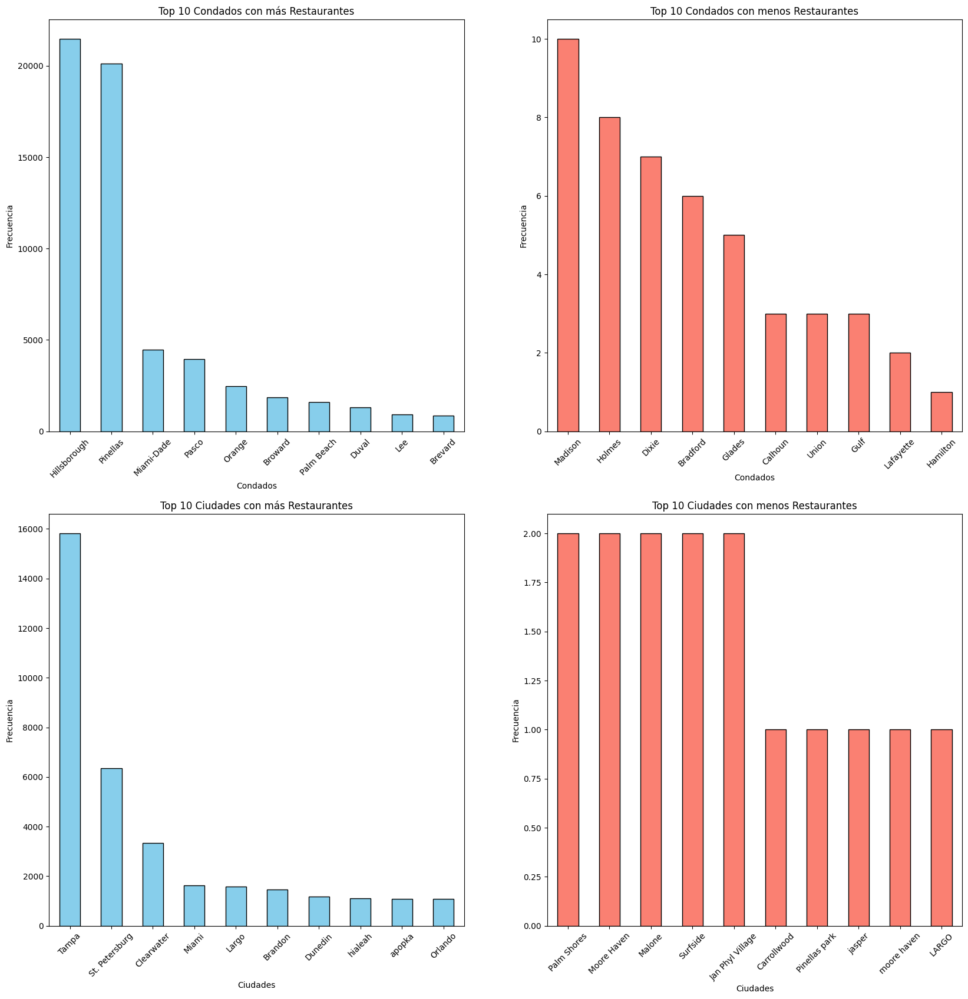

In [60]:
import matplotlib.pyplot as plt
import pandas as pd

# Obtener los 10 condados con más y menos restaurantes
top_10_condados = servicio_restaurantes['condado'].value_counts().head(10)
bottom_10_condados = servicio_restaurantes['condado'].value_counts().tail(10)

# Obtener las 10 con más y menos restaurantes
top_10_ciudades = servicio_restaurantes['ciudad'].value_counts().head(10)
bottom_10_ciudades = servicio_restaurantes['ciudad'].value_counts().tail(10)

# # Mostrar los resultados como tablas
# print("Top 10 Condados más comunes:")
# print(top_10_condados)

# print("\nTop 10 Condados menos comunes:")
# print(bottom_10_condados)

# Crear una figura con subplots (2 filas x 2 columnas)
fig, axes = plt.subplots(2, 2, figsize=(20, 20))

# Gráfico 1: Top 10 Condados con más Restaurantes
top_10_condados.plot(kind='bar', color='skyblue', edgecolor='black', ax=axes[0, 0])
axes[0, 0].set_title("Top 10 Condados con más Restaurantes")
axes[0, 0].set_xlabel("Condados")
axes[0, 0].set_ylabel("Frecuencia")
axes[0, 0].tick_params(axis='x', rotation=45)

# Gráfico 2: Top 10 Condados con menos Restaurantes
bottom_10_condados.plot(kind='bar', color='salmon', edgecolor='black', ax=axes[0, 1])
axes[0, 1].set_title("Top 10 Condados con menos Restaurantes")
axes[0, 1].set_xlabel("Condados")
axes[0, 1].set_ylabel("Frecuencia")
axes[0, 1].tick_params(axis='x', rotation=45)

# Gráfico 3: Top 10 Ciudades con más Restaurantes
top_10_ciudades.plot(kind='bar', color='skyblue', edgecolor='black', ax=axes[1, 0])
axes[1, 0].set_title("Top 10 Ciudades con más Restaurantes")
axes[1, 0].set_xlabel("Ciudades")
axes[1, 0].set_ylabel("Frecuencia")
axes[1, 0].tick_params(axis='x', rotation=45)

# Gráfico 4: Top 10 Ciudades con menos Restaurantes
bottom_10_ciudades.plot(kind='bar', color='salmon', edgecolor='black', ax=axes[1, 1])
axes[1, 1].set_title("Top 10 Ciudades con menos Restaurantes")
axes[1, 1].set_xlabel("Ciudades")
axes[1, 1].set_ylabel("Frecuencia")
axes[1, 1].tick_params(axis='x', rotation=45)


*Conclusión:* 

### **Relación entre variables**
- Latitud_ciudad y longitud_ciudad con puntuacion_usuarios
- Latitud_condado y longitud_condado con puntuacion_usuarios
- 

In [61]:
import plotly.express as px

# Crear el mapa
fig = px.scatter_mapbox(
    servicio_restaurantes,
    lat='latitud_ciudad',
    lon='longitud_ciudad',
    color='puntuacion_usuarios',
    size='puntuacion_usuarios',
    hover_name='servicios_restaurantes',
    hover_data={'ciudad': True, 'condado': True},
    color_continuous_scale=px.colors.sequential.Viridis,
    zoom=6,
    title='Distribución geográfica (Ciudades) de servicios por puntuación'
)

# Configurar mapa base (requiere token de Mapbox)
fig.update_layout(mapbox_style='carto-positron')
fig.show()


In [62]:
import plotly.express as px

# Crear el mapa
fig = px.scatter_mapbox(
    servicio_restaurantes,
    lat='latitud_condado',
    lon='longitud_condado',
    color='puntuacion_usuarios',
    size='puntuacion_usuarios',
    hover_name='servicios_restaurantes',
    hover_data={'ciudad': True, 'condado': True},
    color_continuous_scale=px.colors.sequential.Viridis,
    zoom=6,
    title='Distribución geográfica (Condado) de servicios por puntuación'
)

# Configurar mapa base (requiere token de Mapbox)
fig.update_layout(mapbox_style='carto-positron')
fig.show()

In [63]:

heatmap = folium.Map(location=[27.994402, -81.760254], zoom_start=7)

# Crear lista de ubicaciones
locations = servicio_restaurantes[["latitud_ciudad", "longitud_ciudad", 'puntuacion_usuarios']].dropna().values.tolist()

# Añadir HeatMap
HeatMap(locations, radius=10, blur=15, max_zoom=13).add_to(heatmap)

heatmap

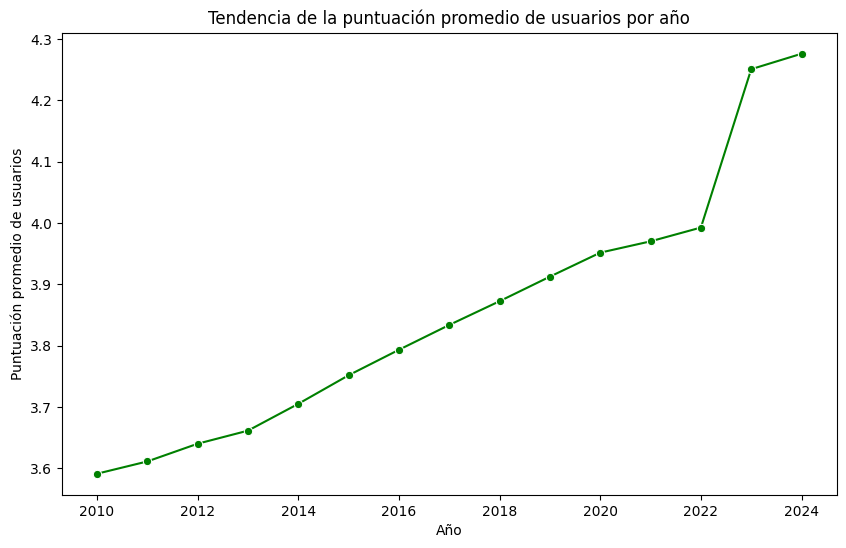

In [64]:
# Agrupar por año y calcular la puntuación promedio de los usuarios
puntuacion_promedio = servicio_restaurantes.groupby('anio')['puntuacion_usuarios'].mean().reset_index()

plt.figure(figsize=(10, 6))
sns.lineplot(
    data=puntuacion_promedio,
    x='anio',
    y='puntuacion_usuarios',
    marker='o',  # Marca los puntos de cada año
    color='g'
)

plt.title('Tendencia de la puntuación promedio de usuarios por año')
plt.xlabel('Año')
plt.ylabel('Puntuación promedio de usuarios')
plt.show()

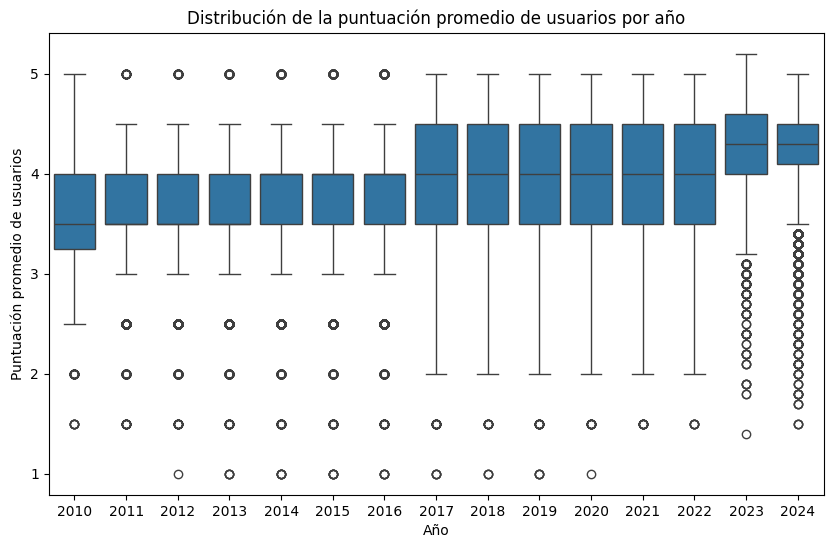

In [65]:
plt.figure(figsize=(10, 6))
sns.boxplot(data=servicio_restaurantes, x='anio', y='puntuacion_usuarios')
plt.title('Distribución de la puntuación promedio de usuarios por año')
plt.xlabel('Año')
plt.ylabel('Puntuación promedio de usuarios')
plt.show()
plt.show()


*Conclusión:* 

### Evaluación de zona con pocos restaurantes con buena puntuación
Ciudades con poca/mediana cantidad de restaurantes en base a los condados


In [67]:
# Calcular el número de restaurantes por ciudad y condado
ciudades_restaurantes = servicio_restaurantes.groupby(['condado', 'ciudad'])['id_servicios_restaurantes'].count().reset_index()
ciudades_restaurantes.columns = ['condado', 'ciudad', 'cantidad_restaurantes']

# Definir límites para categorizar cantidad de restaurantes
percentil_25 = ciudades_restaurantes['cantidad_restaurantes'].quantile(0.25)
percentil_75 = ciudades_restaurantes['cantidad_restaurantes'].quantile(0.75)

# Clasificar ciudades según la cantidad de restaurantes
ciudades_restaurantes['categoria_cantidad_restaurantes'] = ciudades_restaurantes['cantidad_restaurantes'].apply(
    lambda x: 'Pocos Restaurantes' if x < percentil_25 else 
              'Rango Medio' if x <= percentil_75 else 
              'Alta concentración'
)

# Calcular la puntuación promedio por ciudad, condado y año
ciudades_puntuacion = servicio_restaurantes.groupby(['condado', 'ciudad', 'anio'])['puntuacion_usuarios'].mean().reset_index()
ciudades_puntuacion.columns = ['condado', 'ciudad', 'anio', 'puntuacion_promedio']

# Clasificar puntuaciones como "Regular", "Buena" o "Excelente"
def clasificar_puntuacion(puntuacion):
    if puntuacion >= 4.5:
        return 'Excelente'
    elif puntuacion >= 4.0:
        return 'Buena'
    else:
        return 'Regular'

ciudades_puntuacion['categoria_puntuacion'] = ciudades_puntuacion['puntuacion_promedio'].apply(clasificar_puntuacion)
ciudades_puntuacion['puntuacion_promedio'] = ciudades_puntuacion['puntuacion_promedio'].round(1)

# Unir clasificaciones de cantidad de restaurantes con puntuaciones promedio
ciudades_clasificadas = ciudades_restaurantes.merge(ciudades_puntuacion, on=['condado', 'ciudad'])

# Generar la tabla final ciudades_filtradas
ciudades_filtradas = ciudades_clasificadas[['condado', 'ciudad', 'cantidad_restaurantes', 
                                            'categoria_cantidad_restaurantes', 'anio', 
                                            'puntuacion_promedio', 'categoria_puntuacion']]

# Ver los primeros resultados
ciudades_filtradas.head(10)

,condado,ciudad,cantidad_restaurantes,categoria_cantidad_restaurantes,anio,puntuacion_promedio,categoria_puntuacion
0,Alachua,Alachua,8,Rango Medio,2024,4.6,Excelente
1,Alachua,Archer,3,Pocos Restaurantes,2024,3.5,Regular
2,Alachua,Gainesville,236,Alta concentración,2024,4.2,Buena
3,Alachua,High Springs,14,Rango Medio,2024,4.1,Buena
4,Alachua,Jonesville,5,Pocos Restaurantes,2024,4.3,Buena
5,Alachua,Newberry,26,Rango Medio,2024,4.3,Buena
6,Alachua,Waldo,2,Pocos Restaurantes,2024,4.5,Excelente
7,Alachua,gainesville,144,Alta concentración,2023,4.3,Buena
8,Alachua,gainesville,144,Alta concentración,2024,4.3,Buena
9,Baker,Macclenny,24,Rango Medio,2024,4.2,Buena


In [68]:
# para análisis en powerbi
servicio_restaurantes.to_csv('data_informe/servicio_restaurantes_df.csv', index= False)
categorias_restaurant.to_csv('data_informe/categorias_restaurant.csv', index= False)
categoria_generales.to_csv('data_informe/categoria_generales.csv', index= False)

# Tablas
puntuacion_promedio.to_csv('data_informe/puntuacion_promedio.csv', index=False)
ciudades_filtradas.to_csv('data_informe/ciudades_inversion.csv', index=False)